In [1]:
import pickle 
import numpy as np
import sys
sys.path.append('/scratch/programming/preprocessing-pipeline/in_development/Will/')
sys.path.append('/scratch/programming/preprocessing-pipeline/src')
from cell_extractor.CellDetectorBase import CellDetectorBase
from cell_extractor.CellAnnotationUtilities import CellAnnotationUtilities
from cell_extractor.DetectionPlotter import DetectionPlotter
from cell_extractor.ExampleFinder import ExampleFinder
util = CellAnnotationUtilities()
plotter = DetectionPlotter()

In [7]:
test_counts,train_sections = pickle.load(open('/scratch/programming/categories_round2.pkl','rb'))
coords = np.array([[i[1]['x'],i[1]['y'],i[1]['section']] for i in train_sections['computer missed, human detected']])
sections = np.unique(coords[:,2].astype('int'))
coords = coords[np.argsort(coords[:,2])]

In [8]:
corresponding_examples = []
for sectioni in sections:
    coords_in_section = coords[coords[:,2]==sectioni][:,:2]
    base = CellDetectorBase('DK55',sectioni)
    base.load_examples()
    examples = np.array([examplei for tilei in base.Examples for examplei in tilei])
    example_coord = np.array([np.array([examplei['col'],examplei['row']])+np.flip(examplei['origin']) for examplei in examples])
    ids = util.find_cloest_neighbor_among_points(example_coord,coords_in_section,max_distance = 500)
    corresponding_examples.append(examples[ids])
corresponding_examples = np.concatenate(corresponding_examples)

In [9]:
section_and_tile = []
for examplei in corresponding_examples:
    section = examplei['section']
    base = CellDetectorBase('DK55',section)
    origin_to_tile = {value:key for key, value in base.tile_origins.items()}
    tile = origin_to_tile[tuple(examplei['origin'])]
    section_and_tile.append((section,tile))

In [10]:
unique_section_and_tile = np.unique(np.array(section_and_tile),axis=0)
images = []
scatters = []
for sectioni,tilei in unique_section_and_tile:
    finder = ExampleFinder('DK55',sectioni)
    finder.load_and_preprocess_image(tilei)
    finder.find_connected_segments(finder.difference_ch3)
    nsegments,mask,stats,location = finder.connected_segment_info
    examples_in_tile = np.all(section_and_tile == np.array([sectioni,tilei]),axis=1)
    coords_in_tile = coords[examples_in_tile]
    examples_in_tile = corresponding_examples[examples_in_tile]
    i=0
    for examplei in examples_in_tile:
        col,row=examplei['col'],examplei['row']
        index = np.argmin(np.sum(np.abs((location-np.array([col,row]))),axis=1))
        y,x = location[index]
        xmin,xmax = int(x-200),int(x+200)
        ymin,ymax = int(y-200),int(y+200)
        coordx,coordy = np.flip(coords_in_tile[i,:2])-examplei['origin']
        scatters.append([coordx-xmin,coordy-ymin])
        images.append(mask[xmin:xmax,ymin:ymax])
        images.append(finder.ch1_image[xmin:xmax,ymin:ymax])
        images.append(finder.ch3_image[xmin:xmax,ymin:ymax])
        i+=1

section=153, SECTION_DIR=//net/birdstore/Active_Atlas_Data//cell_segmentation/DK55/CH3/153
5
section=154, SECTION_DIR=//net/birdstore/Active_Atlas_Data//cell_segmentation/DK55/CH3/154
5
section=161, SECTION_DIR=//net/birdstore/Active_Atlas_Data//cell_segmentation/DK55/CH3/161
5
section=162, SECTION_DIR=//net/birdstore/Active_Atlas_Data//cell_segmentation/DK55/CH3/162
5
section=163, SECTION_DIR=//net/birdstore/Active_Atlas_Data//cell_segmentation/DK55/CH3/163
5
section=163, SECTION_DIR=//net/birdstore/Active_Atlas_Data//cell_segmentation/DK55/CH3/163
7
section=165, SECTION_DIR=//net/birdstore/Active_Atlas_Data//cell_segmentation/DK55/CH3/165
5
section=166, SECTION_DIR=//net/birdstore/Active_Atlas_Data//cell_segmentation/DK55/CH3/166
7
section=167, SECTION_DIR=//net/birdstore/Active_Atlas_Data//cell_segmentation/DK55/CH3/167
5
section=168, SECTION_DIR=//net/birdstore/Active_Atlas_Data//cell_segmentation/DK55/CH3/168
5
section=169, SECTION_DIR=//net/birdstore/Active_Atlas_Data//cell_segme

In [23]:
sections[10]

170

In [19]:
number_of_sections = [sum(coords[:,2]==sectioni) for sectioni in sections]

In [25]:
c = np.cumsum(number_of_sections)
c[:11]

array([ 3,  5,  7, 10, 16, 18, 19, 24, 26, 28, 35])

In [22]:
images[34*3].shape

(0, 400)

In [26]:
unique_section_and_tile

array([[153,   5],
       [154,   5],
       [161,   5],
       [162,   5],
       [163,   5],
       [163,   7],
       [165,   5],
       [166,   7],
       [167,   5],
       [168,   5],
       [169,   5],
       [170,   5],
       [170,   7],
       [171,   5],
       [171,   7],
       [172,   5],
       [173,   5],
       [173,   7],
       [174,   5],
       [174,   7],
       [175,   5],
       [175,   7],
       [176,   5],
       [176,   7],
       [177,   5],
       [177,   7],
       [178,   5],
       [178,   7],
       [179,   5],
       [179,   7],
       [180,   5],
       [181,   5],
       [182,   5],
       [182,   7],
       [183,   5],
       [184,   5],
       [185,   5],
       [186,   7],
       [187,   5],
       [187,   7],
       [189,   5],
       [191,   5],
       [191,   7],
       [192,   5],
       [193,   5],
       [194,   3],
       [194,   5],
       [194,   7],
       [195,   5],
       [195,   7],
       [197,   5],
       [197,   7],
       [198,

In [28]:
imagest = []
scatterst = []
sectioni = 170
tilei = 7
finder = ExampleFinder('DK55',sectioni)
finder.load_and_preprocess_image(tilei)
finder.find_connected_segments(finder.difference_ch3)
nsegments,mask,stats,location = finder.connected_segment_info
examples_in_tile = np.all(section_and_tile == np.array([sectioni,tilei]),axis=1)
coords_in_tile = coords[examples_in_tile]
examples_in_tile = corresponding_examples[examples_in_tile]
i=0
for examplei in examples_in_tile:
    col,row=examplei['col'],examplei['row']
    index = np.argmin(np.sum(np.abs((location-np.array([col,row]))),axis=1))
    y,x = location[index]
    xmin,xmax = int(x-200),int(x+200)
    ymin,ymax = int(y-200),int(y+200)
    coordx,coordy = np.flip(coords_in_tile[i,:2])-examplei['origin']
    scatterst.append([coordx-xmin,coordy-ymin])
    imagest.append(mask[xmin:xmax,ymin:ymax])
    imagest.append(finder.ch1_image[xmin:xmax,ymin:ymax])
    imagest.append(finder.ch3_image[xmin:xmax,ymin:ymax])
    i+=1

section=170, SECTION_DIR=//net/birdstore/Active_Atlas_Data//cell_segmentation/DK55/CH3/170
7


In [11]:
import pickle
pickle.dump((coords,corresponding_examples,images,scatters),open('save.pkl','wb'))

In [12]:
import pickle
(coords,corresponding_examples,images,scatters) = pickle.load(open('save.pkl','rb'))

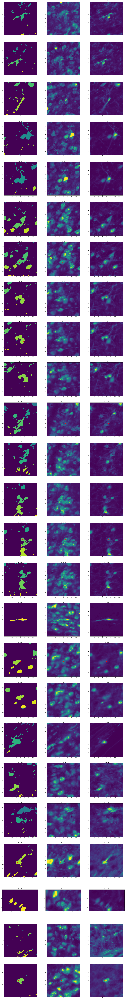

In [3]:
nplot = 25
for starti in range(0,len(scatters),nplot):
    endi = starti+nplot
    titles = np.repeat([f'{i} th plot' for i in range(nplot)],3,axis=0)
    plotter.save_plot_image_array(images[3*starti:3*endi],save_path = f'/data/missed_cells/image_{starti}_{endi}.jpg',ncol=3,scatters=np.repeat(scatters[starti:endi],3,axis=0),subplot_size = 10,titles = titles)

In [3]:
import matplotlib.pyplot as plt

/scratch/programming/preprocessing-pipeline/in_development/Will/cell_extractor/DetectionPlotter.py:11: UserWarning: Attempting to set identical bottom == top == -0.5 results in singular transformations; automatically expanding.
  ax.imshow(images[i])


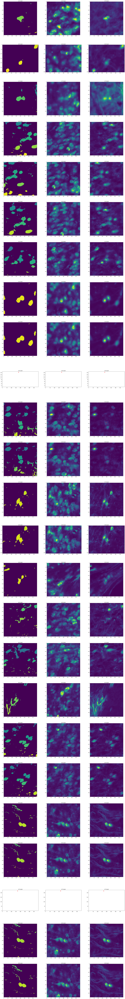

In [14]:
nplot = 25
starti = 25
endi = starti+nplot
titles = np.repeat([f'{i+starti} th plot' for i in range(nplot)],3,axis=0)
plotter.plot_image_array(images[3*starti:3*endi],ncol=3,scatters=np.repeat(scatters[starti:endi],3,axis=0),subplot_size = 10,titles = titles)

In [83]:
import matplotlib.pyplot as plt

class Plotter:
    def plot_image_array(self,images,ncol = 5,titles=None,scatters = None,subplot_size = 2):
        nimage = len(images) 
        nrow = nimage//ncol+1
        plt.figure(figsize = [subplot_size*ncol,subplot_size*nrow])
        for i in range(nimage):
            ax = plt.subplot(nrow,ncol,i+1)
            ax.imshow(images[i])
            if type(titles) != type(None):
                ax.set_title(titles[i])
            if type(scatters)!=type(None):
                ax.scatter(scatters[i][1],scatters[i][0],color='r')
        plt.show()

class DetectionPlotter(Plotter):

    def plot_examplei(self,examplei = 0):
        assert(hasattr(self, 'Examples'))
        examplei = self.Examples[examplei][0]
        ch1 = examplei['image_CH1']
        ch3 = examplei['image_CH3']
        plt.imshow(ch1)
        plt.show()
        plt.imshow(ch3)
        plt.show()
    
    def plot_examples(self,examples,channel = 3):
        nexamples = len(examples)
        images = [examplei[f'image_CH{channel}'] for examplei in examples]
        titles = ['%d, %d'%(i,examples[i]['area']) for i in range(nexamples)]
        self.plot_image_array(images,titles = titles)
plotter = DetectionPlotter()